<a href="https://colab.research.google.com/github/dhanushvemulapalli/Comprehensive-Traffic-Flow-and-Safety-Analysis/blob/main/ADS_Project.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **Inspiration**

How has changing traffic flow impacted accidents?

Can we predict accident rates over time? What might improve accident rates?

Plot interactive maps of changing trends, e.g. How has London has changed for cyclists? Busiest roads in the nation?

Which areas never change and why? Identify infrastructure needs, failings and successes.

How have Rural and Urban areas differed (see RoadCategory)? How about the differences between England, Scotland, and Wales?

The UK government also like to look at miles driven. You can do this by multiplying the AADF by the corresponding length of road (link length) and by the number of days in the years. What does this tell you about UK roads?



In [1]:
# Import necessary libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px

# Set plot style for consistency
sns.set(style='whitegrid')
plt.rcParams['figure.figsize'] = (10, 6)


In [2]:
# --- 1. Data Import ---

# Load the UK traffic data (AADF) file
traffic_df = pd.read_csv('/content/drive/MyDrive/ADS/ukTrafficAADF.csv')


In [3]:
traffic_df.head()

,AADFYear,CP,Estimation_method,Estimation_method_detailed,Region,LocalAuthority,Road,RoadCategory,Easting,Northing,...,V2AxleRigidHGV,V3AxleRigidHGV,V4or5AxleRigidHGV,V3or4AxleArticHGV,V5AxleArticHGV,V6orMoreAxleArticHGV,AllHGVs,AllMotorVehicles,Lat,Lon
0,2000,6007,Counted,Manual count,Yorkshire and the Humber,Rotherham,M1,TM,446000,389300,...,5351,656,711,1588,4715,2149,15170,111146,53.398531,-1.309655
1,2000,6009,Counted,Manual count,Yorkshire and the Humber,Leeds,M621,TM,432150,429500,...,1293,272,287,628,1494,921,4895,65939,53.760869,-1.513814
2,2000,6035,Counted,Manual count,Yorkshire and the Humber,Doncaster,M18,TM,466400,407900,...,1952,257,239,745,3695,2000,8888,40229,53.563523,-0.998970
3,2000,6054,Counted,Manual count,Yorkshire and the Humber,Calderdale,M62,TM,404000,416600,...,3121,508,354,1786,5902,3438,15109,85759,53.645893,-1.940967
4,2000,6055,Counted,Manual count,Yorkshire and the Humber,Leeds,M62,TM,426000,426200,...,4030,624,423,1947,6669,3743,17436,98487,53.731551,-1.607374


In [4]:
# Load accident datasets
accidents_2005_2007 = pd.read_csv('/content/drive/MyDrive/ADS/accidents_2005_to_2007.csv')
accidents_2009_2011 = pd.read_csv('/content/drive/MyDrive/ADS/accidents_2009_to_2011.csv')
accidents_2012_2014 = pd.read_csv('/content/drive/MyDrive/ADS/accidents_2012_to_2014.csv')


<ipython-input-4-1e16f39e30d4>:2: DtypeWarning: Columns (31) have mixed types. Specify dtype option on import or set low_memory=False.
  accidents_2005_2007 = pd.read_csv('/content/drive/MyDrive/ADS/accidents_2005_to_2007.csv')
<ipython-input-4-1e16f39e30d4>:4: DtypeWarning: Columns (31) have mixed types. Specify dtype option on import or set low_memory=False.
  accidents_2012_2014 = pd.read_csv('/content/drive/MyDrive/ADS/accidents_2012_to_2014.csv')


In [5]:
# Combine accident data into one DataFrame
accidents_df = pd.concat([accidents_2005_2007, accidents_2009_2011, accidents_2012_2014], ignore_index=True)


In [6]:
# --- 2. Data Cleaning and Feature Engineering ---

# Convert 'Date' column to datetime format (if available)
if 'Date' in accidents_df.columns:
    accidents_df['Date'] = pd.to_datetime(accidents_df['Date'], format='%d/%m/%Y')

# Extract year from 'Date' if missing
if 'Year' not in accidents_df.columns and 'Date' in accidents_df.columns:
    accidents_df['Year'] = accidents_df['Date'].dt.year

# Calculate 'miles driven' for each traffic record
if 'AllMotorVehicles' in traffic_df.columns and 'LinkLength_miles' in traffic_df.columns:
    traffic_df['miles_driven'] = traffic_df['AllMotorVehicles'] * traffic_df['LinkLength_miles'] * 365


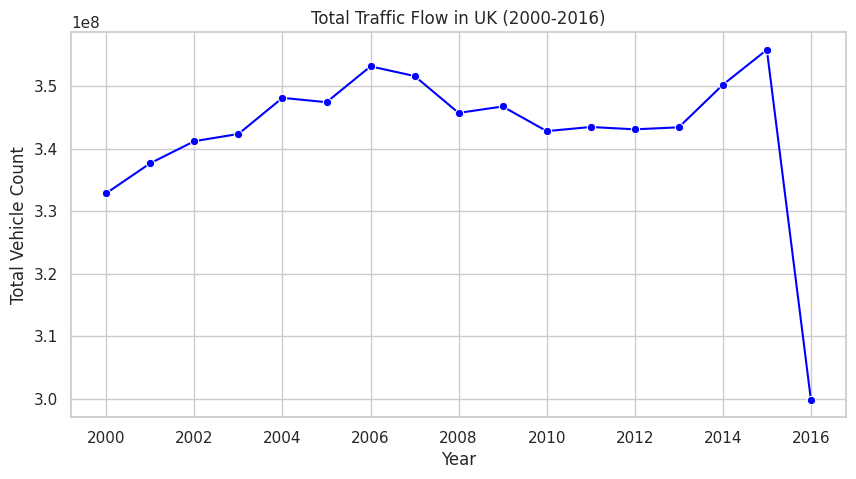

In [7]:
# --- 3. Exploratory Data Analysis (EDA) ---

# 3.1 Traffic Trends Over Time
if 'AADFYear' in traffic_df.columns:
    yearly_traffic = traffic_df.groupby('AADFYear')['AllMotorVehicles'].sum().reset_index()
    plt.figure(figsize=(10, 5))
    sns.lineplot(x='AADFYear', y='AllMotorVehicles', data=yearly_traffic, marker='o', color='blue')
    plt.title("Total Traffic Flow in UK (2000-2016)")
    plt.xlabel("Year")
    plt.ylabel("Total Vehicle Count")
    plt.grid(True)
    plt.show()


<ipython-input-8-e841468d07ce>:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Year', y='accident_count', data=yearly_accidents, palette='coolwarm')


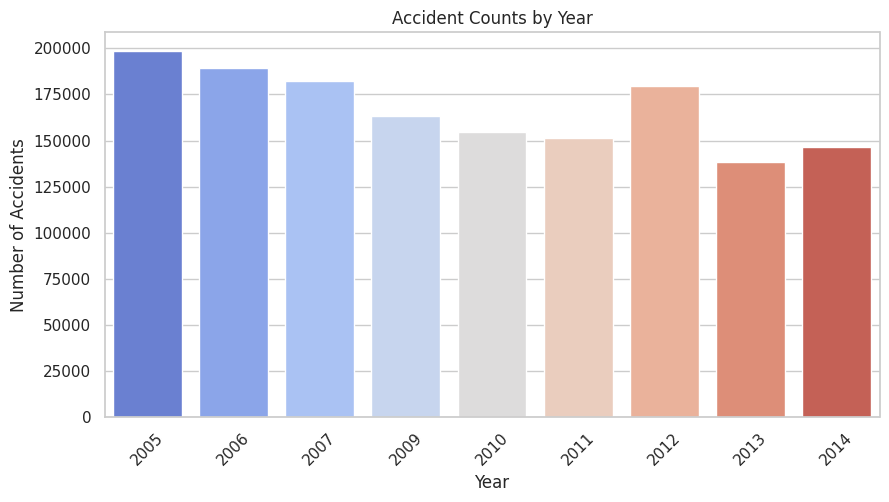

In [8]:
# 3.2 Accident Counts by Year
if 'Year' in accidents_df.columns:
    yearly_accidents = accidents_df.groupby('Year').size().reset_index(name='accident_count')
    plt.figure(figsize=(10, 5))
    sns.barplot(x='Year', y='accident_count', data=yearly_accidents, palette='coolwarm')
    plt.title("Accident Counts by Year")
    plt.xlabel("Year")
    plt.ylabel("Number of Accidents")
    plt.xticks(rotation=45)
    plt.show()


<ipython-input-9-a9faa31e5a50>:3: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(x='Accident_Severity', data=accidents_df, palette='Reds', order=[1, 2, 3])


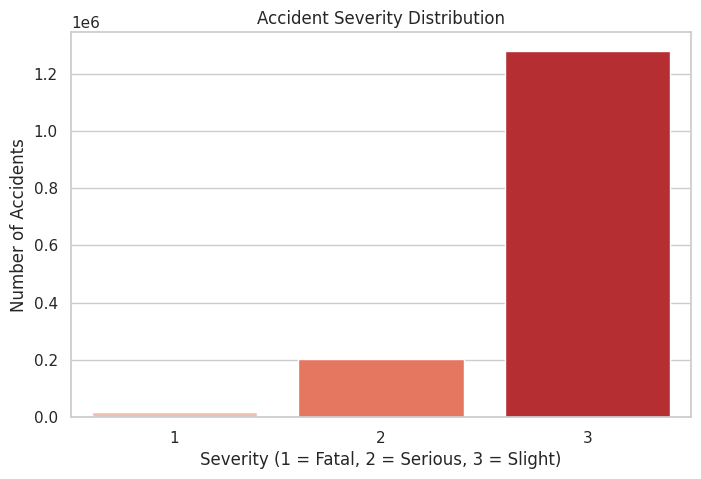

In [9]:
if 'Accident_Severity' in accidents_df.columns:
    plt.figure(figsize=(8, 5))
    sns.countplot(x='Accident_Severity', data=accidents_df, palette='Reds', order=[1, 2, 3])
    plt.title("Accident Severity Distribution")
    plt.xlabel("Severity (1 = Fatal, 2 = Serious, 3 = Slight)")
    plt.ylabel("Number of Accidents")
    plt.show()


<ipython-input-10-e0594581b5a8>:4: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(y='Weather_Conditions', data=accidents_df, order=accidents_df['Weather_Conditions'].value_counts().index, palette='Blues_r')


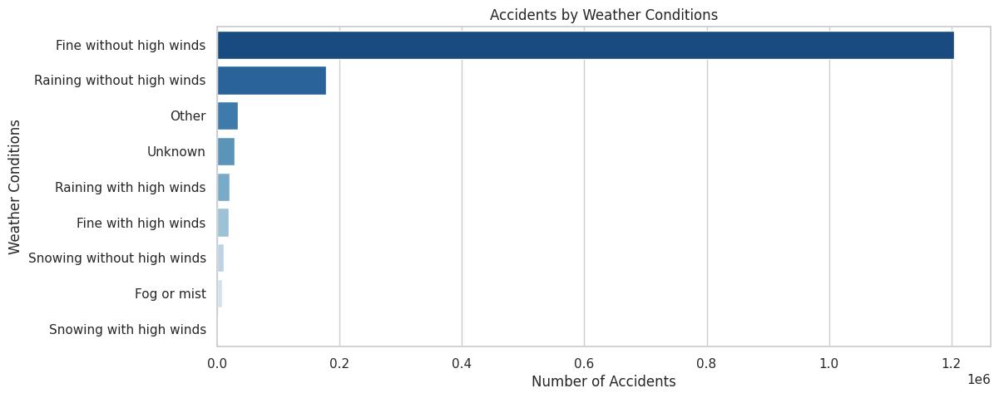

In [10]:
# 3.4 Weather Conditions and Accidents
if 'Weather_Conditions' in accidents_df.columns:
    plt.figure(figsize=(12, 5))
    sns.countplot(y='Weather_Conditions', data=accidents_df, order=accidents_df['Weather_Conditions'].value_counts().index, palette='Blues_r')
    plt.title("Accidents by Weather Conditions")
    plt.xlabel("Number of Accidents")
    plt.ylabel("Weather Conditions")
    plt.show()


<ipython-input-11-1490137f03d9>:4: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(x='Urban_or_Rural_Area', data=accidents_df, palette='Set2')


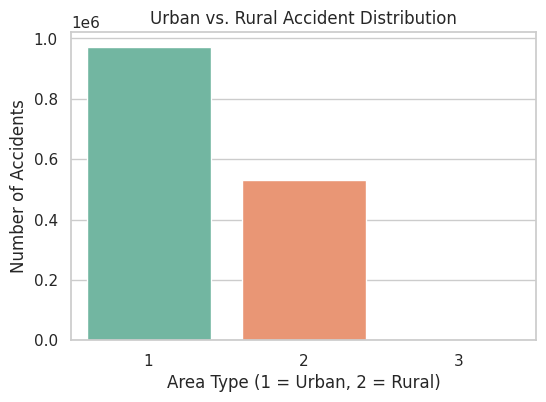

In [11]:
# 3.5 Urban vs. Rural Accidents
if 'Urban_or_Rural_Area' in accidents_df.columns:
    plt.figure(figsize=(6, 4))
    sns.countplot(x='Urban_or_Rural_Area', data=accidents_df, palette='Set2')
    plt.title("Urban vs. Rural Accident Distribution")
    plt.xlabel("Area Type (1 = Urban, 2 = Rural)")
    plt.ylabel("Number of Accidents")
    plt.show()


In [12]:
# 4.1 Scatter Plot: Traffic Flow vs. Miles Driven
if 'AllMotorVehicles' in traffic_df.columns and 'miles_driven' in traffic_df.columns:
    fig = px.scatter(traffic_df, x='AllMotorVehicles', y='miles_driven',
                     title='Traffic Flow vs. Miles Driven',
                     labels={'AllMotorVehicles': 'Traffic Volume', 'miles_driven': 'Miles Driven'},
                     hover_data=['Road'])
    fig.show()


In [ ]:
# 4.2 Interactive Map of Traffic Data (if lat/lon available)
if 'Lat' in traffic_df.columns and 'Lon' in traffic_df.columns:
    fig = px.scatter_mapbox(traffic_df,
                            lat='Lat', lon='Lon',
                            color='AllMotorVehicles',
                            size='AllMotorVehicles',
                            hover_name='Road',
                            mapbox_style="carto-positron",
                            title='Traffic Flow Map')
    fig.show()


In [ ]:
# 4.3 Interactive Map of Accident Locations (if lat/lon available)
if 'Latitude' in accidents_df.columns and 'Longitude' in accidents_df.columns:
    fig = px.scatter_mapbox(accidents_df,
                            lat='Latitude', lon='Longitude',
                            color='Accident_Severity',
                            size_max=10,
                            hover_name='Accident_Index',
                            mapbox_style="carto-positron",
                            title='Accident Locations in the UK')
    fig.show()


Buffered data was truncated after reaching the output size limit.

In [13]:
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import train_test_split


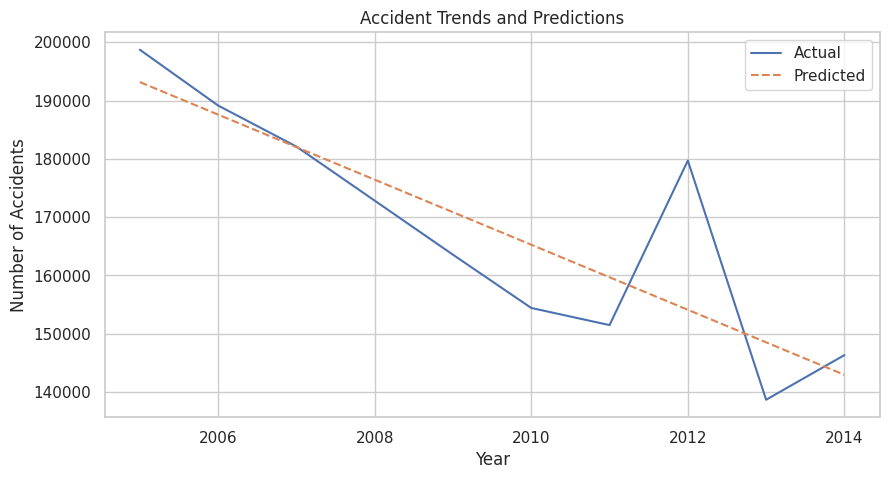

In [14]:
# --- 1. Predicting Accident Rates (Time-Series Forecasting) ---
if 'Year' in accidents_df.columns:
    yearly_accidents = accidents_df.groupby('Year').size().reset_index(name='accident_count')

    # Train a simple linear regression model
    X = yearly_accidents[['Year']]
    y = yearly_accidents['accident_count']

    model = LinearRegression()
    model.fit(X, y)
    yearly_accidents['Predicted'] = model.predict(X)

    # Plot actual vs predicted accident trends
    plt.figure(figsize=(10,5))
    sns.lineplot(x='Year', y='accident_count', data=yearly_accidents, label='Actual')
    sns.lineplot(x='Year', y='Predicted', data=yearly_accidents, linestyle='dashed', label='Predicted')
    plt.title('Accident Trends and Predictions')
    plt.xlabel('Year')
    plt.ylabel('Number of Accidents')
    plt.legend()
    plt.show()


In [19]:
traffic_df.columns

Index(['AADFYear', 'CP', 'Estimation_method', 'Estimation_method_detailed',
       'Region', 'LocalAuthority', 'Road', 'RoadCategory', 'Easting',
       'Northing', 'StartJunction', 'EndJunction', 'LinkLength_km',
       'LinkLength_miles', 'PedalCycles', 'Motorcycles', 'CarsTaxis',
       'BusesCoaches', 'LightGoodsVehicles', 'V2AxleRigidHGV',
       'V3AxleRigidHGV', 'V4or5AxleRigidHGV', 'V3or4AxleArticHGV',
       'V5AxleArticHGV', 'V6orMoreAxleArticHGV', 'AllHGVs', 'AllMotorVehicles',
       'Lat', 'Lon', 'miles_driven'],
      dtype='object')

In [20]:
# --- 3. Identifying Unchanging Roads ---
if 'AADFYear' in traffic_df.columns:
    traffic_stability = traffic_df.groupby('Road')['AllMotorVehicles'].std().reset_index(name='AADF_Std')
    stable_roads = traffic_stability[traffic_stability['AADF_Std'] < 500]  # Low standard deviation implies stability

    print("Most Stable Roads:")
    print(stable_roads.sort_values(by='AADF_Std').head(10))


Most Stable Roads:
        Road   AADF_Std
827    A4510   0.000000
865   A48(M)   0.000000
1312   A6192   0.000000
1685     M41   0.000000
1562    A880  26.877582
234    A1384  31.112698
342    A2039  31.112698
1486   A8003  31.802354
1577    A897  71.672538
968    A5084  73.146057


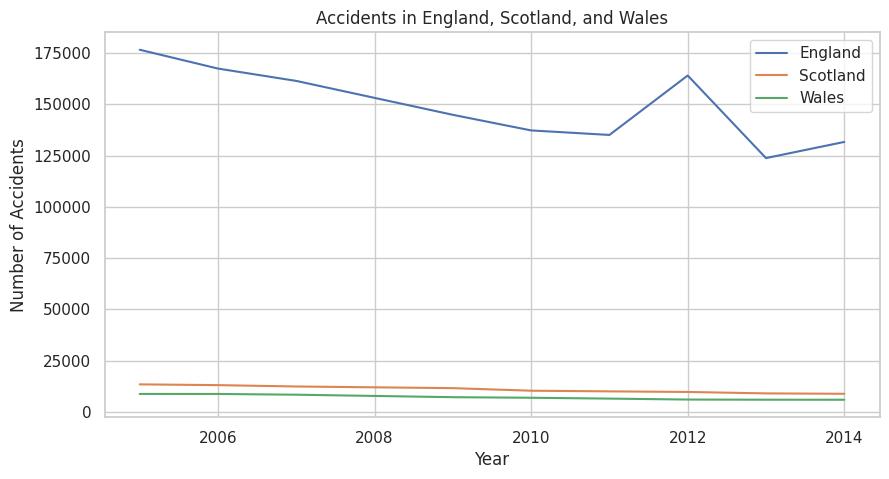

In [21]:
# --- 4. Country-Level Comparisons ---
if 'Local_Authority_(Highway)' in accidents_df.columns:
    accidents_df['Country'] = accidents_df['Local_Authority_(Highway)'].apply(lambda x: 'England' if 'E' in str(x) else ('Scotland' if 'S' in str(x) else 'Wales'))
    country_accidents = accidents_df.groupby(['Year', 'Country']).size().reset_index(name='Accident Count')

    plt.figure(figsize=(10,5))
    sns.lineplot(x='Year', y='Accident Count', hue='Country', data=country_accidents)
    plt.title('Accidents in England, Scotland, and Wales')
    plt.xlabel('Year')
    plt.ylabel('Number of Accidents')
    plt.legend()
    plt.show()


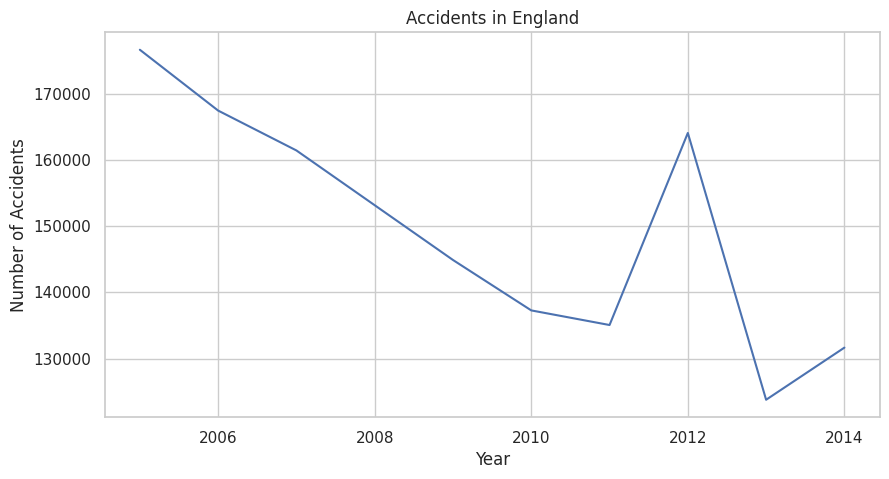

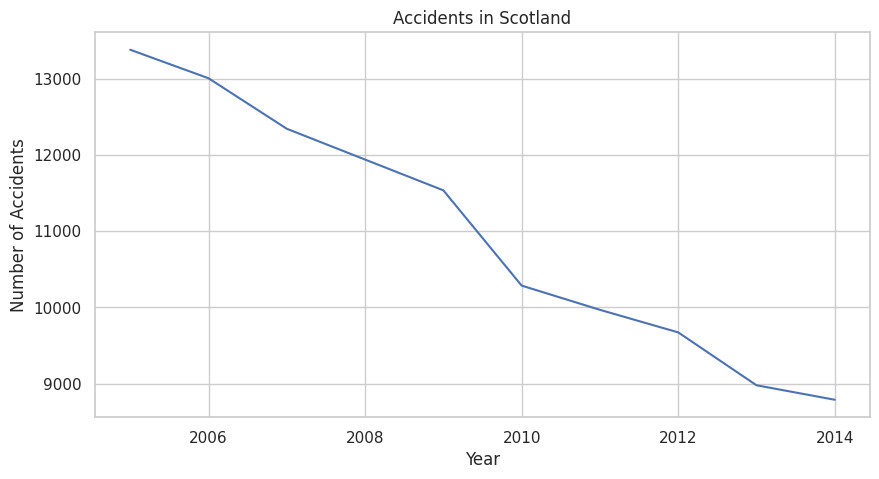

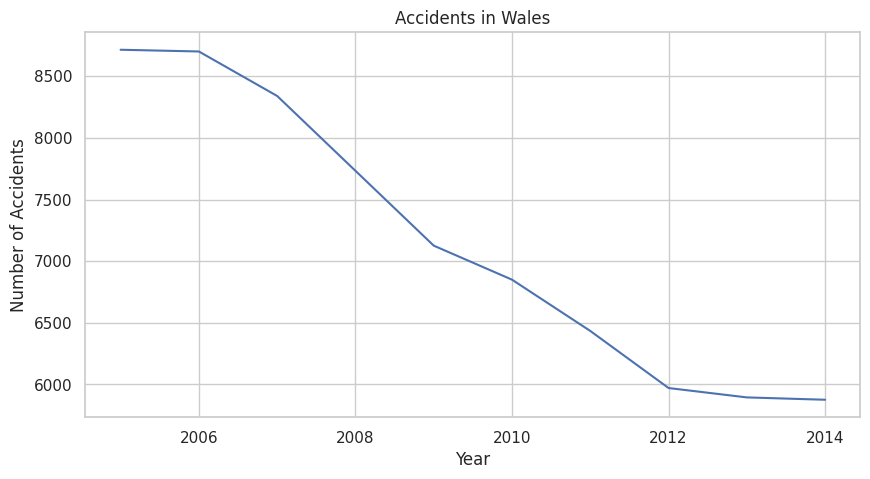

In [22]:
if 'Local_Authority_(Highway)' in accidents_df.columns:
    accidents_df['Country'] = accidents_df['Local_Authority_(Highway)'].apply(lambda x: 'England' if 'E' in str(x) else ('Scotland' if 'S' in str(x) else 'Wales'))

    for country in ['England', 'Scotland', 'Wales']:
        country_accidents = accidents_df[accidents_df['Country'] == country].groupby('Year').size().reset_index(name='Accident Count')

        plt.figure(figsize=(10,5))
        sns.lineplot(x='Year', y='Accident Count', data=country_accidents)
        plt.title(f'Accidents in {country}')
        plt.xlabel('Year')
        plt.ylabel('Number of Accidents')
        plt.show()
